In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## Experimental response correlation between pairs of substrates

In [24]:
data = pd.read_csv('../data/experimental_response/jnjdata_sm12378_MeOH_16h.csv', sep = ';')
print(len(data))
data.head(2)

960


,Substrate,Ligand#,Temperature/C,Hydrogen/bar,Conversion,Eesign,EE,DDG,DConversion
0,SM1,L1,25,5,1.0,0.36,0.36,1.86,0.0
1,SM1,L2,25,5,1.0,0.00,0.00,0.02,0.0


In [102]:
df = data.pivot(index='Ligand#', columns='Substrate', values='DDG')
np.mean(np.array(df.values), axis = 0)

array([3.74953125, 4.97265625, 3.23463542, 1.48567708, 1.38098958])

In [103]:
df = data.pivot(index='Ligand#', columns='Substrate', values='Conversion')
np.mean(np.array(df.values), axis = 0)

array([0.77677083, 0.83791667, 0.75583333, 0.68411458, 0.78130208])

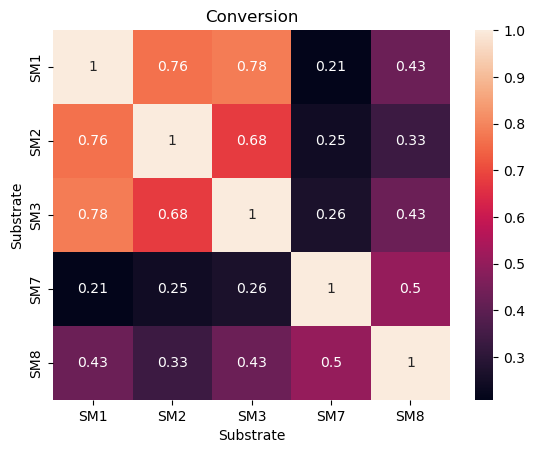

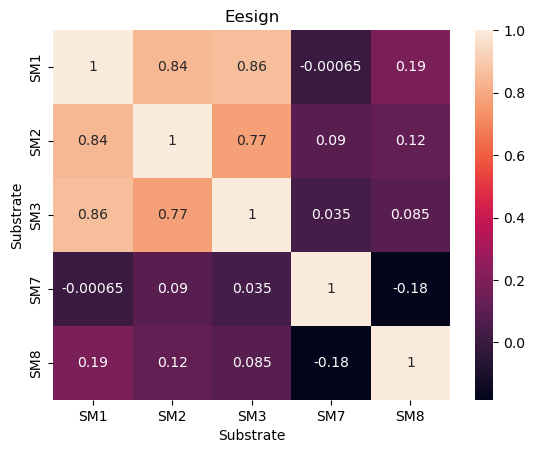

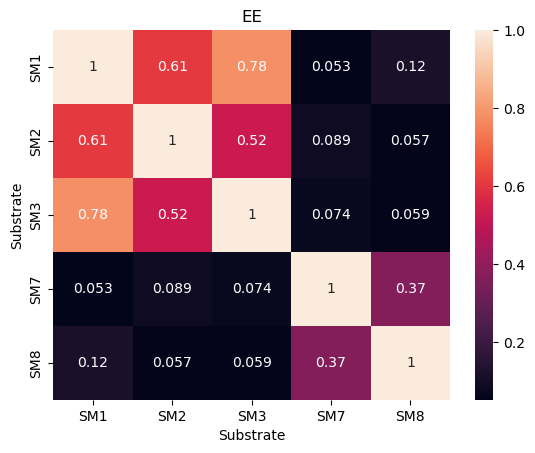

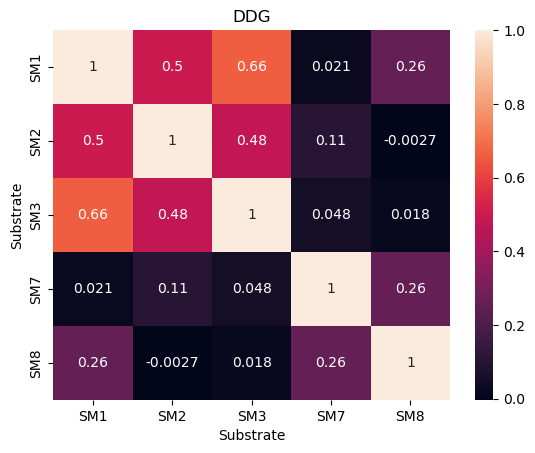

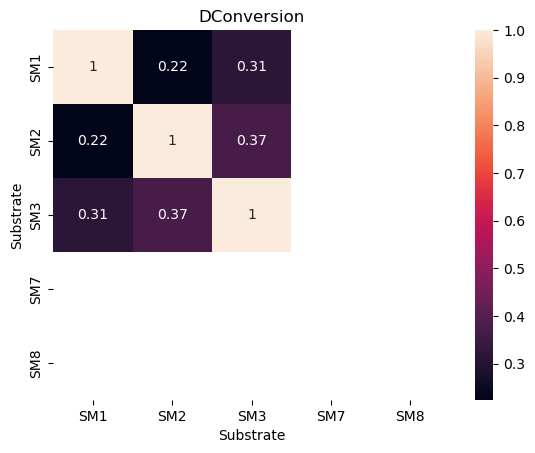

In [16]:
for target in ['Conversion', 'Eesign','EE', 'DDG', 'DConversion']:
    df = data.pivot(index='Ligand#', columns='Substrate', values=target).corr()
    
    ax = plt.axes()
    sns.heatmap(df, ax = ax, annot=True)
    ax.set_title(target)
    plt.show()

## Univariate correlation analysis descriptors and experimental response

In [47]:
AVAILABLE_LIGAND_REPRESENTATION_TYPES = ['dft_nbd_model', 'dl_chylon', 'ecfp', 'sigmangroup']
thr = 0.5
for target in ['Conversion', 'Eesign','EE', 'DDG', 'DConversion']:
    df = data.pivot(index='Ligand#', columns='Substrate', values=target)
    df = df.reset_index()
    
    for descr in AVAILABLE_LIGAND_REPRESENTATION_TYPES:
        print(f'\nTarget = {target} & Descriptors = {descr}')
        df2 = pd.read_csv(f'../data/ligand_representations/ligands_{descr}.csv', sep = ';|,',engine='python')
        df_tmp = df.merge(df2, on='Ligand#')
        df_tmp = df_tmp.corr().iloc[5:,:5]
        df_tmp = df_tmp.loc[df_tmp[(df_tmp > thr)|(df_tmp < -thr)].any(axis=1)]
        if df_tmp.empty:
            print(f'no corr > {thr}')
        else:
            print(df_tmp)


 Target = Conversion & Descriptors = dft_nbd_model
                                          SM1       SM2       SM3       SM7  \
dispersion_p_int_donor_max_gfn2_xtb -0.650114 -0.552972 -0.604450 -0.215291   
ip_gfn2_xtb                         -0.600938 -0.525226 -0.578412 -0.223771   
dipole_gfn2_xtb                      0.607792  0.506783  0.568340  0.249746   
nucleofugality_gfn2_xtb              0.521231  0.424257  0.506241  0.163117   
lone_pair_occupancy_min_donor_dft    0.603968  0.509898  0.568465  0.236150   
electrophilicity_dft                -0.628493 -0.546557 -0.577417 -0.170860   

                                          SM8  
dispersion_p_int_donor_max_gfn2_xtb -0.220306  
ip_gfn2_xtb                         -0.230444  
dipole_gfn2_xtb                      0.247263  
nucleofugality_gfn2_xtb              0.136315  
lone_pair_occupancy_min_donor_dft    0.233911  
electrophilicity_dft                -0.190231  

 Target = Conversion & Descriptors = dl_chylon
no corr > 

## Chemical space visualization concatenated descriptors


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substratedft_steric_fingerprint
[0.2306359  0.10259528 0.09099611 0.06731962 0.05407534 0.05032283
 0.04272406 0.03433701 0.02758963 0.02436256 0.02369113 0.02262732]


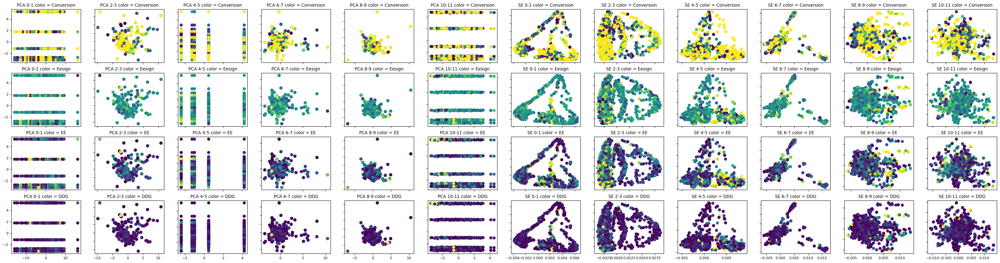


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substratesmiles_steric_fingerprint
[0.2306359  0.09099611 0.08381907 0.07051474 0.06731962 0.05032283
 0.04272405 0.03433729 0.02758851 0.02545865 0.0243639  0.02369101]


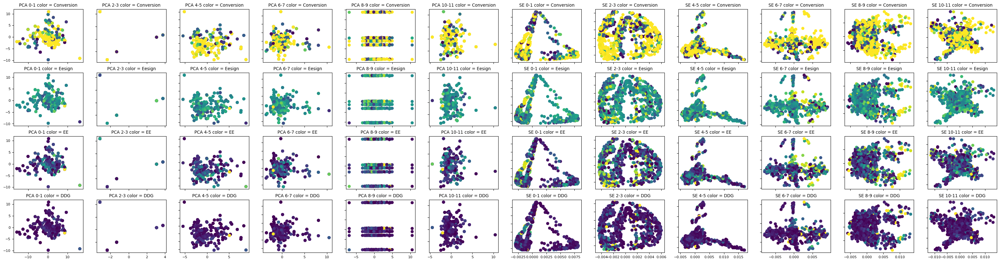


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substratedl_chylon
[0.33508544 0.28447169 0.18629733 0.12168178 0.02047311 0.00807755
 0.00597584 0.00446706 0.00379253 0.00304806 0.00244908 0.00216276]


/projects/home/cvalsecc/condaenv/obelix/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


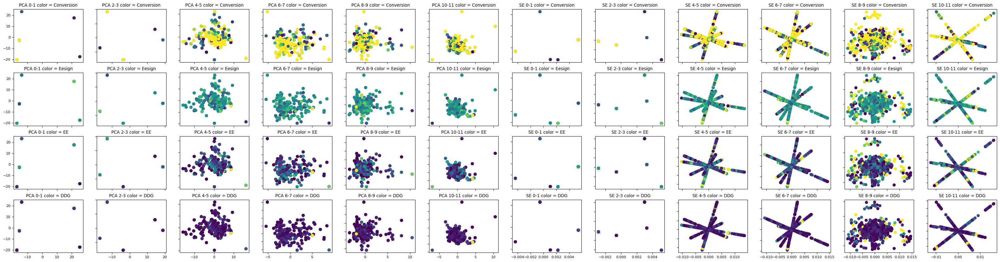


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substrateecfp
[0.17938348 0.13380014 0.12551681 0.07333754 0.07077475 0.0523597
 0.03913999 0.03322983 0.03242488 0.02670683 0.02145863 0.01894987]


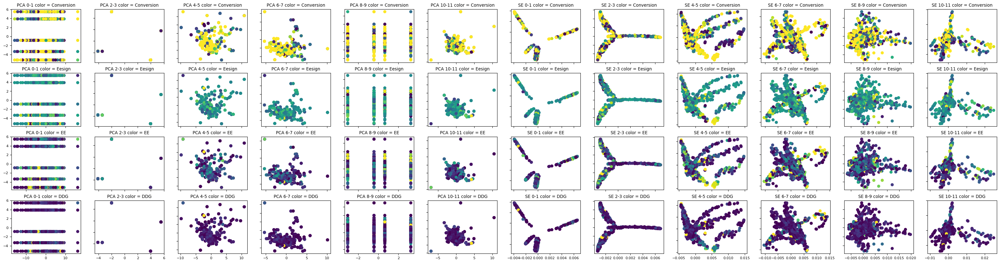


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substraterdkit
[0.26448637 0.21861833 0.1202251  0.05568622 0.04743414 0.03567717
 0.03509214 0.02623212 0.02227106 0.01789926 0.01438185 0.01270044]


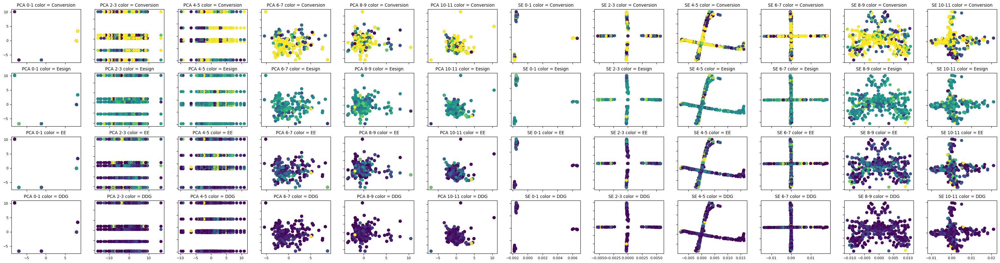


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substratesterimol
[0.24837713 0.09799581 0.07249805 0.05729244 0.05419382 0.04601052
 0.03697856 0.03021796 0.02970956 0.0262336  0.02551076 0.02259606]


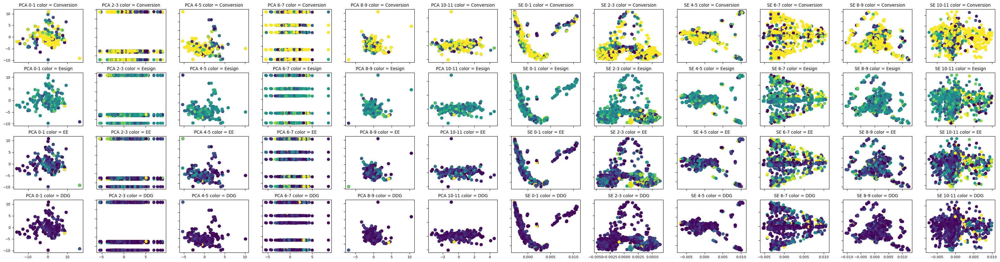


Target = DConversion & Descriptors ligand= dft_nbd_model & Descriptors substrateohe
[0.26590963 0.10491316 0.07761556 0.05801927 0.04925831 0.03958878
 0.03180777 0.02807129 0.02730323 0.02419002 0.02213411 0.01900063]


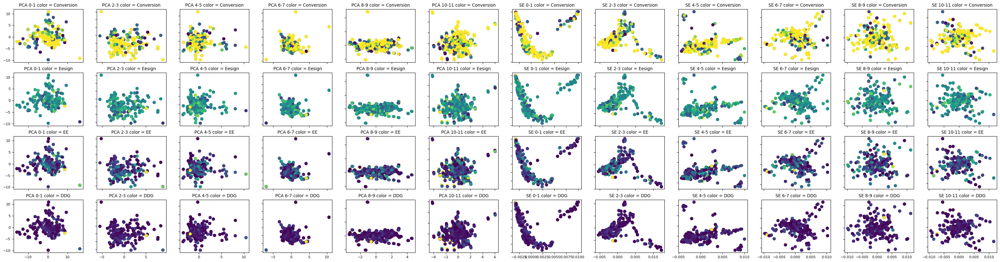


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substratedft_steric_fingerprint
[0.20120848 0.09319031 0.08507965 0.05610476 0.04626577 0.04402729
 0.03806916 0.03268422 0.02774914 0.02112858 0.01767102 0.01603544]


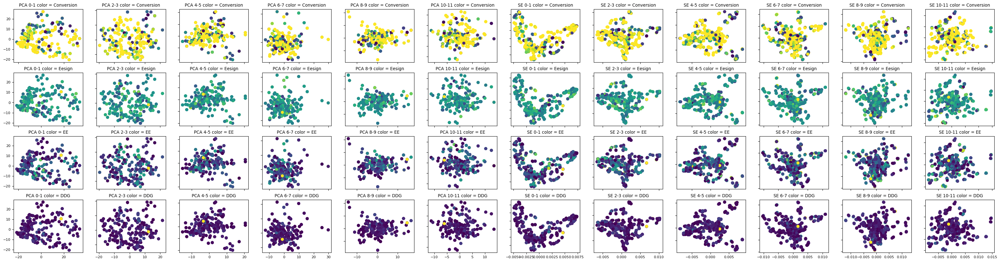


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substratesmiles_steric_fingerprint
[0.20120848 0.09319031 0.08507965 0.05610476 0.04626577 0.04402729
 0.03806916 0.03268422 0.02774914 0.02112861 0.01767102 0.0160372 ]


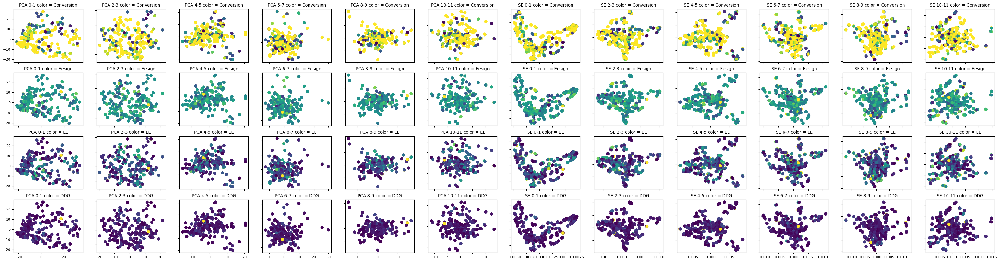


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substratedl_chylon
[0.180632   0.15334802 0.10237268 0.1004259  0.06559408 0.04741421
 0.04328759 0.02854549 0.02353952 0.0224006  0.01936917 0.01662937]


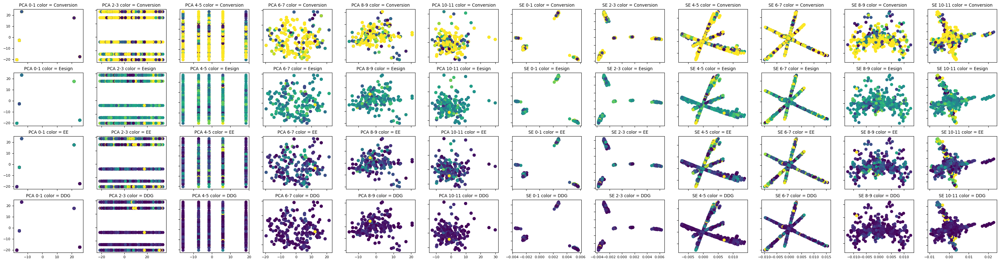


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substrateecfp
[0.19594322 0.09075168 0.08285326 0.0546366  0.04505508 0.04287518
 0.03707296 0.03182893 0.02702299 0.02057569 0.01720778 0.01575566]


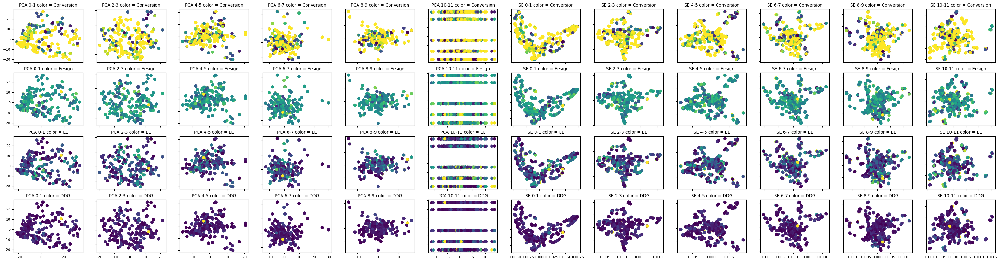


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substraterdkit
[0.18521134 0.08578119 0.07831537 0.05164413 0.0439253  0.04258739
 0.04052689 0.03630764 0.03504246 0.03008565 0.02554293 0.01944874]


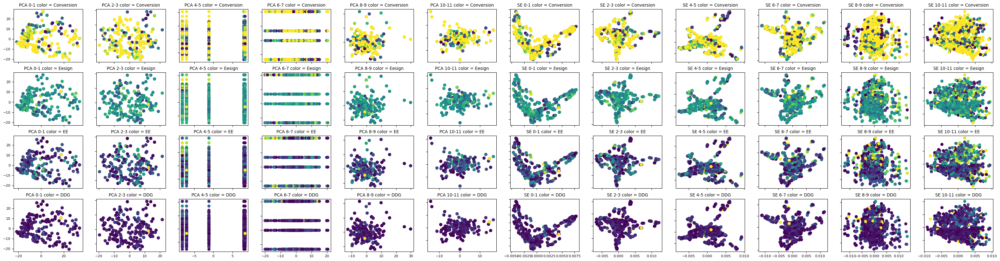


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substratesterimol
[0.20256931 0.09382058 0.08565507 0.05648421 0.04657868 0.04432506
 0.03832663 0.03290527 0.02793681 0.02127151 0.01779049 0.01614512]


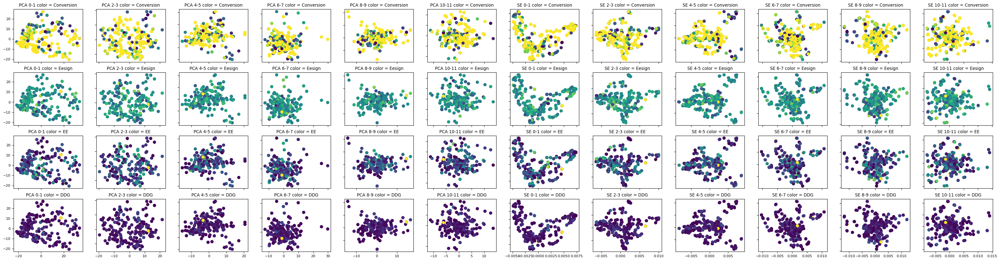


Target = DConversion & Descriptors ligand= dl_chylon & Descriptors substrateohe
[0.20375048 0.09436764 0.08615451 0.05681356 0.04685027 0.04458352
 0.03855011 0.03309714 0.02809971 0.02139554 0.01789431 0.01623958]


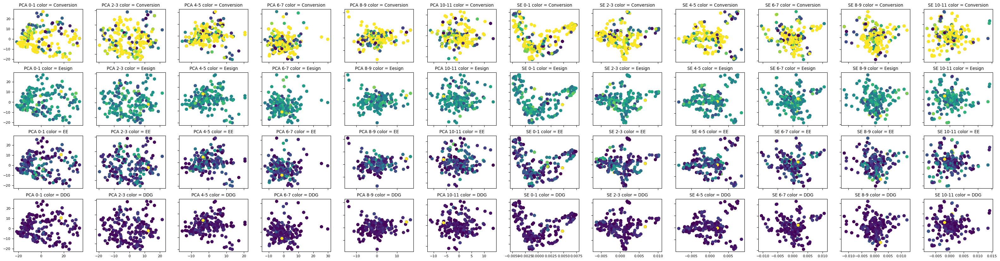


Target = DConversion & Descriptors ligand= ecfp & Descriptors substratedft_steric_fingerprint
[0.03529843 0.03106816 0.03008524 0.02712993 0.02638931 0.02250719
 0.02069215 0.01973136 0.01885993 0.01803758 0.01760667 0.01753334]


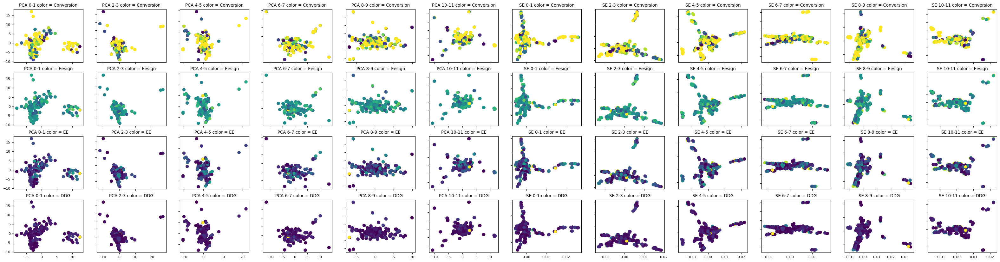


Target = DConversion & Descriptors ligand= ecfp & Descriptors substratesmiles_steric_fingerprint
[0.03529845 0.03106806 0.03008529 0.02712958 0.02638891 0.02250064
 0.02070088 0.01972578 0.01887711 0.01799259 0.01752635 0.01738251]


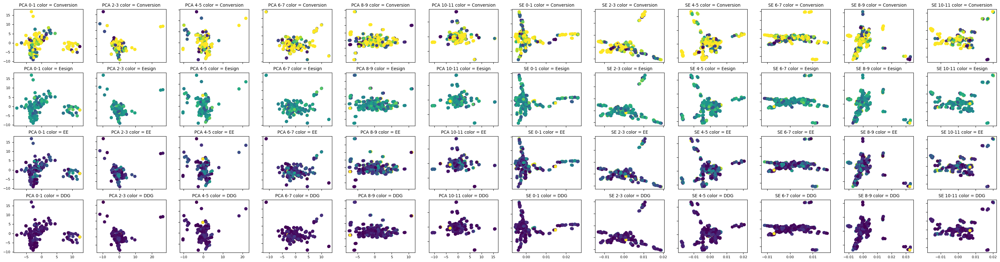


Target = DConversion & Descriptors ligand= ecfp & Descriptors substratedl_chylon
[0.23164329 0.19665419 0.12878663 0.08411815 0.01306285 0.01149731
 0.0111336  0.01003994 0.00976574 0.00832662 0.007663   0.00730404]


/projects/home/cvalsecc/condaenv/obelix/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


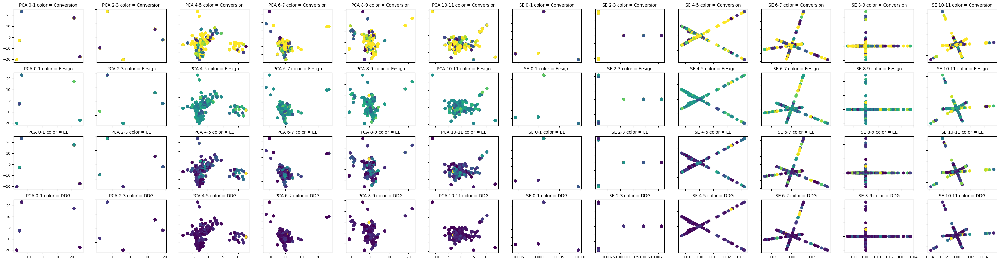


Target = DConversion & Descriptors ligand= ecfp & Descriptors substrateecfp
[0.03370173 0.02966257 0.02872434 0.02723502 0.02590168 0.02554872
 0.02519557 0.02145942 0.01973595 0.01882535 0.01797717 0.01715943]


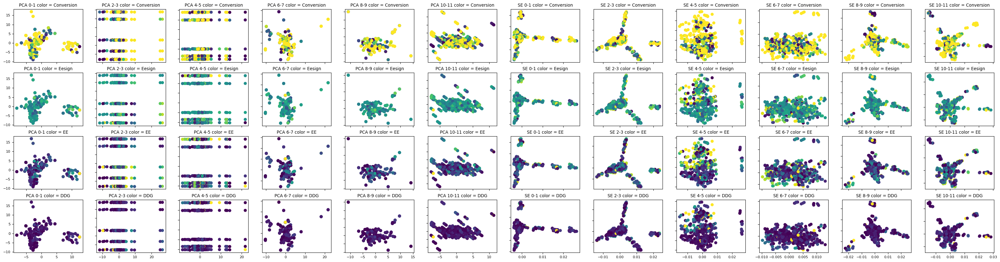


Target = DConversion & Descriptors ligand= ecfp & Descriptors substraterdkit
[0.07301533 0.06035278 0.03063346 0.02696203 0.0261093  0.02354406
 0.02289962 0.01953325 0.01794681 0.01707796 0.01632325 0.01554222]


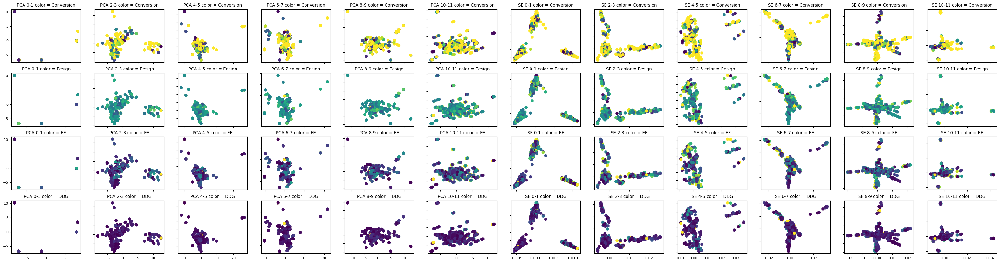


Target = DConversion & Descriptors ligand= ecfp & Descriptors substratesterimol
[0.03572152 0.03144049 0.03044576 0.0274552  0.0267052  0.02277441
 0.02095477 0.01996046 0.01906879 0.01823882 0.0178234  0.01770487]


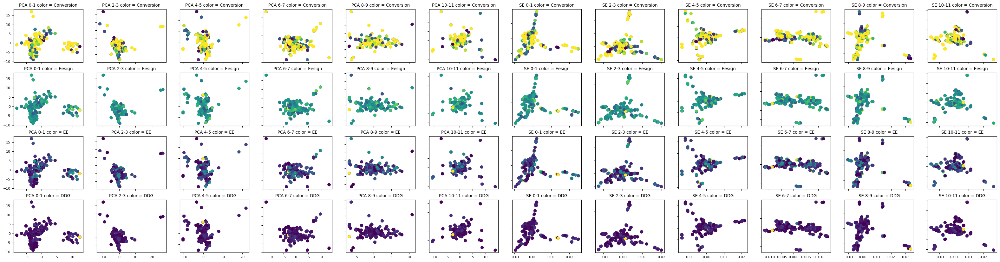


Target = DConversion & Descriptors ligand= ecfp & Descriptors substrateohe
[0.03609237 0.0317668  0.03076191 0.02773988 0.02698258 0.02300347
 0.02116979 0.02015065 0.01928787 0.01835653 0.01802877 0.01790552]


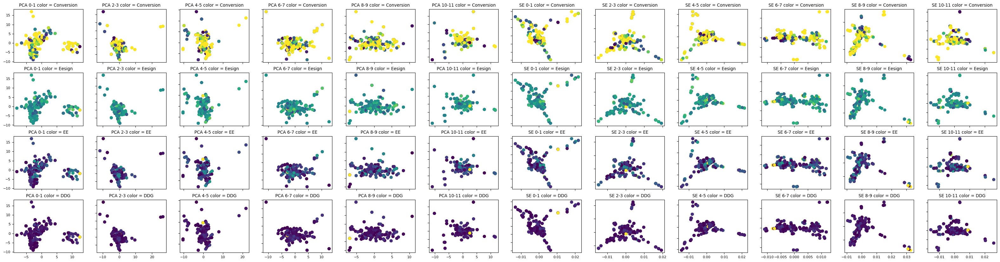


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substratedft_steric_fingerprint
[0.17263161 0.14054364 0.09290006 0.0744196  0.06558285 0.04993238
 0.04444598 0.04072459 0.0362065  0.02754237 0.02397017 0.02079832]


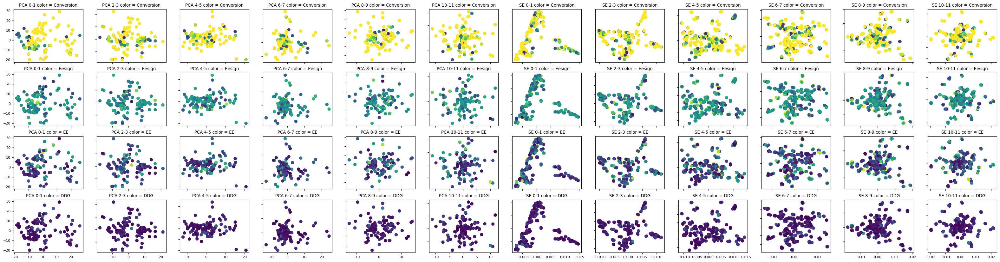


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substratesmiles_steric_fingerprint
[0.17263161 0.14054364 0.09290006 0.0744196  0.06558285 0.04993238
 0.04444598 0.04072459 0.0362065  0.02754237 0.02397017 0.02079832]


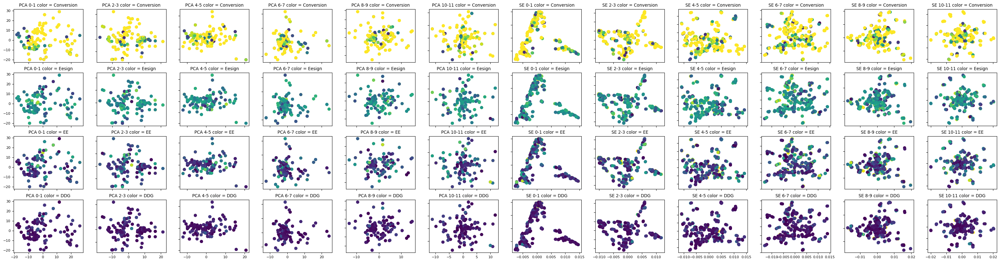


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substratedl_chylon
[0.21595699 0.18333727 0.12006553 0.07842188 0.07124959 0.05800604
 0.03834229 0.03071492 0.02706776 0.0206084  0.01834402 0.0168081 ]


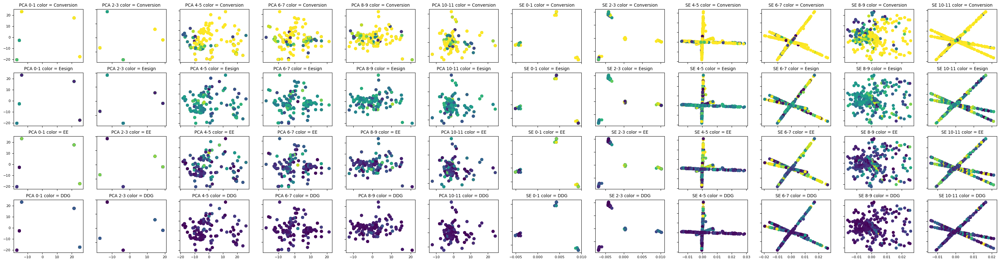


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substrateecfp
[0.16605517 0.1351896  0.08936101 0.07158457 0.06308445 0.04803019
 0.0427528  0.03917317 0.03482721 0.02649314 0.02305702 0.02293716]


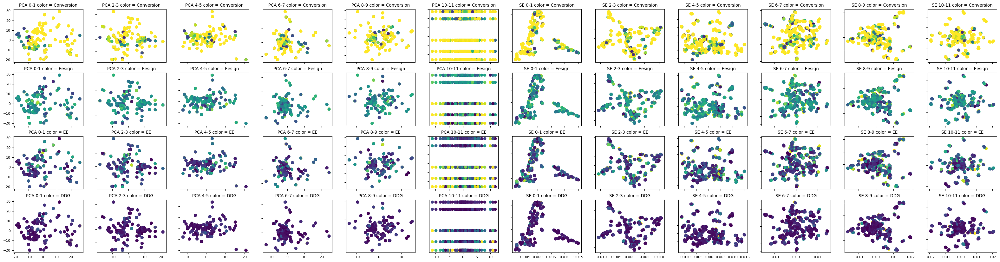


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substraterdkit
[0.15313745 0.12467296 0.08240947 0.06601589 0.06238825 0.058177
 0.05156869 0.04429384 0.03942698 0.03612583 0.03211794 0.02443219]


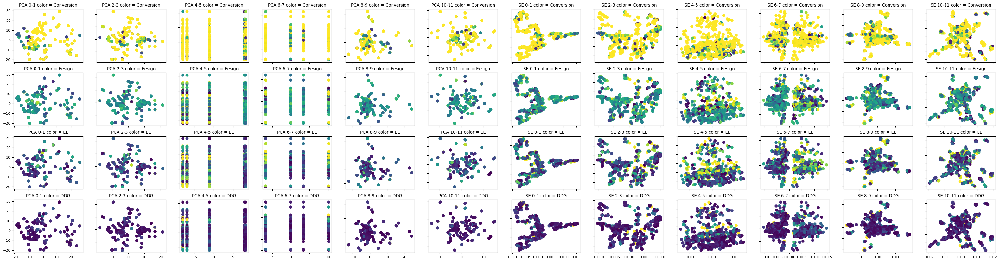


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substratesterimol
[0.17435792 0.14194908 0.09382906 0.0751638  0.06623867 0.0504317
 0.04489044 0.04113183 0.03656857 0.02781779 0.02420987 0.0210063 ]


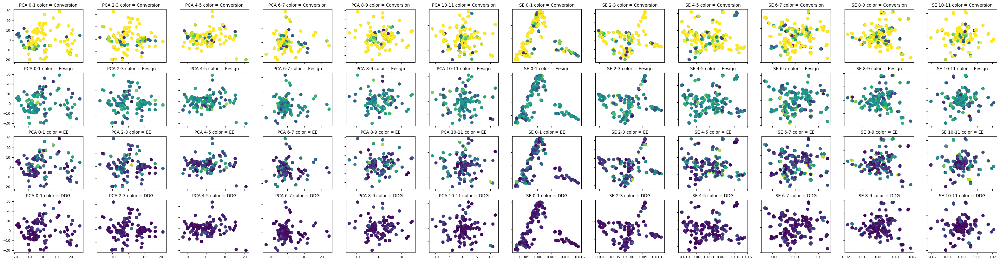


Target = DConversion & Descriptors ligand= sigmangroup & Descriptors substrateohe
[0.17586534 0.1431763  0.09464027 0.07581363 0.06681134 0.05086771
 0.04527854 0.04148744 0.03688472 0.02805829 0.02441918 0.02118791]


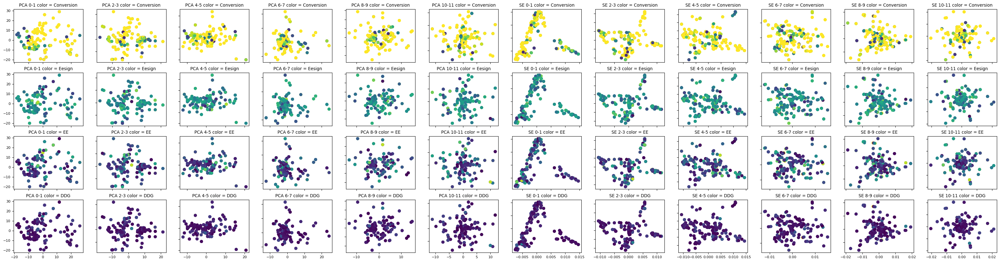

In [93]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import SpectralEmbedding

plt.rcParams.update({'font.size': 8})

AVAILABLE_LIGAND_REPRESENTATION_TYPES = ['dft_nbd_model', 'dl_chylon', 'ecfp', 'sigmangroup']
AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES = ['dft_steric_fingerprint', 'smiles_steric_fingerprint', 'dl_chylon', 'ecfp', 'rdkit', 'sterimol', 'ohe']
thr = 0.5

df = data.loc[:,['Substrate','Ligand#','Conversion','Eesign','EE','DDG','DConversion']]

for descr_L in AVAILABLE_LIGAND_REPRESENTATION_TYPES:
    for descr_S in AVAILABLE_SUBSTRATE_REPRESENTATION_TYPES:
        print(f'\nTarget = {target} & Descriptors ligand= {descr_L} & Descriptors substrate{descr_S}')
        dfL = pd.read_csv(f'../data/ligand_representations/ligands_{descr_L}.csv', sep = ';|,',engine='python')
        dfS = pd.read_csv(f'../data/substrate_representations/substrates_{descr_S}.csv', sep = ';|,',engine='python')

        df_tmp = df.merge(dfL, on='Ligand#')
        df_tmp = df_tmp.merge(dfS, left_on='Substrate',right_on='index')
        df_tmp = df_tmp.drop('index', axis = 1)
        
        #remove constant columns
        df_tmp= df_tmp.loc[:, (df_tmp != df_tmp.iloc[0]).any()]

        x = df_tmp.iloc[:, 7:]
        x.fillna(x.mean(), inplace=True)
        
        x = x.dropna(axis = 1).values
        scaler = StandardScaler()
        x = scaler.fit_transform(x)
        
        pca = PCA(n_components=12)
        emb = SpectralEmbedding(n_components=12)
        
        x_pca = pca.fit_transform(x)
        print(pca.explained_variance_ratio_)
        x_se = emb.fit_transform(x)
        
        fig, axs = plt.subplots(4, 12, figsize=(40,10))
        color_scheme = ['Conversion', 'Eesign','EE', 'DDG', 'DConversion']
        
        pairs = [(0,1),(2,3),(4,5),(6,7),(8,9),(10,11)]
        for i in range(4):
            for j in range(6):
                axs[i, j].scatter(x_pca[:,pairs[j][0]], x_pca[:,pairs[j][1]], c = df_tmp[color_scheme[i]].values)
                axs[i, j].set_title(f'PCA {pairs[j][0]}-{pairs[j][1]} color = {color_scheme[i]}')
                
                axs[i, j+6].scatter(x_se[:,pairs[j][0]], x_se[:,pairs[j][1]], c = df_tmp[color_scheme[i]].values)
                axs[i, j+6].set_title(f'SE {pairs[j][0]}-{pairs[j][1]} color = {color_scheme[i]}')
        for ax in fig.get_axes():
            ax.label_outer()
        plt.show()